In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
data = pd.read_csv("powerconsumption.csv")

In [3]:
data

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
0,01-01-2017 00:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
1,01-01-2017 00:10,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2,01-01-2017 00:20,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
3,01-01-2017 00:30,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
4,01-01-2017 00:40,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964
...,...,...,...,...,...,...,...,...,...
52411,12/30/2017 23:10,7.010,72.4,0.080,0.040,0.096,31160.45627,26857.31820,14780.31212
52412,12/30/2017 23:20,6.947,72.6,0.082,0.051,0.093,30430.41825,26124.57809,14428.81152
52413,12/30/2017 23:30,6.900,72.8,0.086,0.084,0.074,29590.87452,25277.69254,13806.48259
52414,12/30/2017 23:40,6.758,73.0,0.080,0.066,0.089,28958.17490,24692.23688,13512.60504


In [4]:
data.rename(columns={'PowerConsumption_Zone1':'zone1','PowerConsumption_Zone2':'zone2','PowerConsumption_Zone3':'zone3'},inplace=True)

In [5]:
data

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,zone1,zone2,zone3
0,01-01-2017 00:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
1,01-01-2017 00:10,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2,01-01-2017 00:20,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
3,01-01-2017 00:30,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
4,01-01-2017 00:40,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964
...,...,...,...,...,...,...,...,...,...
52411,12/30/2017 23:10,7.010,72.4,0.080,0.040,0.096,31160.45627,26857.31820,14780.31212
52412,12/30/2017 23:20,6.947,72.6,0.082,0.051,0.093,30430.41825,26124.57809,14428.81152
52413,12/30/2017 23:30,6.900,72.8,0.086,0.084,0.074,29590.87452,25277.69254,13806.48259
52414,12/30/2017 23:40,6.758,73.0,0.080,0.066,0.089,28958.17490,24692.23688,13512.60504


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52416 entries, 0 to 52415
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Datetime             52416 non-null  object 
 1   Temperature          52416 non-null  float64
 2   Humidity             52416 non-null  float64
 3   WindSpeed            52416 non-null  float64
 4   GeneralDiffuseFlows  52416 non-null  float64
 5   DiffuseFlows         52416 non-null  float64
 6   zone1                52416 non-null  float64
 7   zone2                52416 non-null  float64
 8   zone3                52416 non-null  float64
dtypes: float64(8), object(1)
memory usage: 3.6+ MB


In [7]:
data['datetime_column'] = pd.to_datetime(data['Datetime'], format='mixed')

data['date'] = data['datetime_column'].dt.date
data['time'] = data['datetime_column'].dt.time

In [8]:
data.drop('Datetime',axis=1,inplace=True)

In [9]:
data

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,zone1,zone2,zone3,datetime_column,date,time
0,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386,2017-01-01 00:00:00,2017-01-01,00:00:00
1,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434,2017-01-01 00:10:00,2017-01-01,00:10:00
2,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373,2017-01-01 00:20:00,2017-01-01,00:20:00
3,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711,2017-01-01 00:30:00,2017-01-01,00:30:00
4,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964,2017-01-01 00:40:00,2017-01-01,00:40:00
...,...,...,...,...,...,...,...,...,...,...,...
52411,7.010,72.4,0.080,0.040,0.096,31160.45627,26857.31820,14780.31212,2017-12-30 23:10:00,2017-12-30,23:10:00
52412,6.947,72.6,0.082,0.051,0.093,30430.41825,26124.57809,14428.81152,2017-12-30 23:20:00,2017-12-30,23:20:00
52413,6.900,72.8,0.086,0.084,0.074,29590.87452,25277.69254,13806.48259,2017-12-30 23:30:00,2017-12-30,23:30:00
52414,6.758,73.0,0.080,0.066,0.089,28958.17490,24692.23688,13512.60504,2017-12-30 23:40:00,2017-12-30,23:40:00


In [10]:
data.drop('datetime_column',axis=1,inplace=True)

In [11]:
data

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,zone1,zone2,zone3,date,time
0,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386,2017-01-01,00:00:00
1,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434,2017-01-01,00:10:00
2,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373,2017-01-01,00:20:00
3,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711,2017-01-01,00:30:00
4,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964,2017-01-01,00:40:00
...,...,...,...,...,...,...,...,...,...,...
52411,7.010,72.4,0.080,0.040,0.096,31160.45627,26857.31820,14780.31212,2017-12-30,23:10:00
52412,6.947,72.6,0.082,0.051,0.093,30430.41825,26124.57809,14428.81152,2017-12-30,23:20:00
52413,6.900,72.8,0.086,0.084,0.074,29590.87452,25277.69254,13806.48259,2017-12-30,23:30:00
52414,6.758,73.0,0.080,0.066,0.089,28958.17490,24692.23688,13512.60504,2017-12-30,23:40:00


In [12]:
data.shape

(52416, 10)

In [13]:
data.sample(3)

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,zone1,zone2,zone3,date,time
36921,21.99,59.75,0.313,215.900,74.000,34757.52212,21528.89813,14102.88049,2017-09-14,09:30:00
39415,25.67,50.45,4.918,262.700,38.920,32467.74617,17578.00830,13002.31003,2017-10-01,17:10:00
43894,19.30,46.63,0.084,0.084,0.041,39680.00000,33586.36364,17586.50602,2017-11-01,19:40:00


In [14]:
print(data.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52416 entries, 0 to 52415
Data columns (total 10 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Temperature          52416 non-null  float64
 1   Humidity             52416 non-null  float64
 2   WindSpeed            52416 non-null  float64
 3   GeneralDiffuseFlows  52416 non-null  float64
 4   DiffuseFlows         52416 non-null  float64
 5   zone1                52416 non-null  float64
 6   zone2                52416 non-null  float64
 7   zone3                52416 non-null  float64
 8   date                 52416 non-null  object 
 9   time                 52416 non-null  object 
dtypes: float64(8), object(2)
memory usage: 4.0+ MB
None


In [15]:
data.describe()

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,zone1,zone2,zone3
count,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000
mean,18.810024,68.259518,1.959489,182.696614,75.028022,32344.970564,21042.509082,17835.406218
std,5.815476,15.551177,2.348862,264.400960,124.210949,7130.562564,5201.465892,6622.165099
min,3.247000,11.340000,0.050000,0.004000,0.011000,13895.696200,8560.081466,5935.174070
25%,14.410000,58.310000,0.078000,0.062000,0.122000,26310.668692,16980.766032,13129.326630
50%,18.780000,69.860000,0.086000,5.035500,4.456000,32265.920340,20823.168405,16415.117470
75%,22.890000,81.400000,4.915000,319.600000,101.000000,37309.018185,24713.717520,21624.100420
max,40.010000,94.800000,6.483000,1163.000000,936.000000,52204.395120,37408.860760,47598.326360


In [16]:
(data.isnull()).sum()

Temperature            0
Humidity               0
WindSpeed              0
GeneralDiffuseFlows    0
DiffuseFlows           0
zone1                  0
zone2                  0
zone3                  0
date                   0
time                   0
dtype: int64

In [17]:
data.isna().sum()

Temperature            0
Humidity               0
WindSpeed              0
GeneralDiffuseFlows    0
DiffuseFlows           0
zone1                  0
zone2                  0
zone3                  0
date                   0
time                   0
dtype: int64

In [18]:
data.duplicated().sum()

0

In [19]:
T_mean= data['Temperature'].mean()
H_mean= data['Humidity'].mean()
W_mean=data['WindSpeed'].mean()
G_mean=data['GeneralDiffuseFlows'].mean()
D_mean=data['DiffuseFlows'].mean()
Z1_mean = data['zone1'].mean()
Z2_mean = data['zone2'].mean()
Z2_mean = data['zone3'].mean()

In [20]:
T_median= data['Temperature'].median()
H_median= data['Humidity'].median()
W_median=data['WindSpeed'].median()
G_median=data['GeneralDiffuseFlows'].median()
D_median=data['DiffuseFlows'].median()
Z1_median = data['zone1'].median()
Z2_median = data['zone2'].median()
Z2_median = data['zone3'].median()

In [21]:
T_mode= data['Temperature'].mode()
H_mode= data['Humidity'].mode()
W_mode=data['WindSpeed'].mode()
G_mode=data['GeneralDiffuseFlows'].mode()
D_mode=data['DiffuseFlows'].mode()
Z1_mode = data['zone1'].mode()
Z2_mode = data['zone2'].mode()
Z2_mode = data['zone3'].mode()

In [22]:
T_std= data['Temperature'].std()
H_std= data['Humidity'].std()
W_std=data['WindSpeed'].std()
G_std=data['GeneralDiffuseFlows'].std()
D_std=data['DiffuseFlows'].std()
Z1_std = data['zone1'].std()
Z2_std = data['zone2'].std()
Z2_std = data['zone3'].std()

In [23]:
T_var= data['Temperature'].var()
H_var= data['Humidity'].var()
W_var=data['WindSpeed'].var()
G_var=data['GeneralDiffuseFlows'].var()
D_var=data['DiffuseFlows'].var()
Z1_var = data['zone1'].var()
Z2_var = data['zone2'].var()
Z2_var = data['zone3'].var()

In [24]:
T_min= data['Temperature'].min()
H_min= data['Humidity'].min()
W_min=data['WindSpeed'].min()
G_min=data['GeneralDiffuseFlows'].min()
D_min=data['DiffuseFlows'].min()
Z1_min = data['zone1'].min()
Z2_min = data['zone2'].min()
Z2_min = data['zone3'].min()

In [25]:
T_max= data['Temperature'].max()
H_max= data['Humidity'].max()
W_max=data['WindSpeed'].max()
G_max=data['GeneralDiffuseFlows'].max()
D_max=data['DiffuseFlows'].max()
Z1_max = data['zone1'].max()
Z2_max = data['zone2'].max()
Z2_max = data['zone3'].max()

In [26]:
fig = px.box(data, y='Temperature', title='Temperature data')
fig.show()

In [27]:
TQ1 = data['Temperature'].quantile(0.25)
TQ3 = data['Temperature'].quantile(0.75)

TIQR = TQ3 - TQ1
print(f"T_IQR: {TIQR}")

lower_bound = TQ1 - 1.5 * TIQR
upper_bound = TQ3 + 1.5 * TIQR

outliers = data[(data['Temperature'] < lower_bound) | (data['Temperature'] > upper_bound)]
num_outliers = outliers.shape[0]

print("Q1 (25th percentile):", TQ1)
print("Q3 (75th percentile):", TQ3)
print("IQR:", TIQR)
print("Lower bound for outliers:", lower_bound)
print("Upper bound for outliers:", upper_bound)
print("\n\n")
print("Number of outliers:", num_outliers)


T_IQR: 8.48
Q1 (25th percentile): 14.41
Q3 (75th percentile): 22.89
IQR: 8.48
Lower bound for outliers: 1.6899999999999995
Upper bound for outliers: 35.61



Number of outliers: 142


In [28]:
fig = px.box(data, y='Humidity', title='Humidity data')
fig.show()

In [29]:
HQ1 = data['Humidity'].quantile(0.25)
HQ3 = data['Humidity'].quantile(0.75)

HIQR = HQ3 - HQ1
print(f"H_IQR: {HIQR}")

lower_bound = HQ1 - 1.5 * HIQR
upper_bound = HQ3 + 1.5 * HIQR

outliers = data[(data['Humidity'] < lower_bound) | (data['Humidity'] > upper_bound)]
num_outliers = outliers.shape[0]

print("Q1 (25th percentile):", HQ1)
print("Q3 (75th percentile):", HQ3)
print("IQR:", HIQR)
print("Lower bound for outliers:", lower_bound)
print("Upper bound for outliers:", upper_bound)
print("\n\n")
print("Number of outliers:", num_outliers)


H_IQR: 23.090000000000003
Q1 (25th percentile): 58.31
Q3 (75th percentile): 81.4
IQR: 23.090000000000003
Lower bound for outliers: 23.674999999999997
Upper bound for outliers: 116.03500000000001



Number of outliers: 291


In [30]:
fig = px.box(data, y='zone1', title='zone1')
fig.show()

In [31]:
fig = px.box(data, y='zone2', title='zone2')
fig.show()

In [32]:
Z2Q1 = data['zone2'].quantile(0.25)
Z2Q3 = data['zone2'].quantile(0.75)

Z2IQR = Z2Q3 - Z2Q1
print(f"H_IQR: {Z2IQR}")

lower_bound = Z2Q1 - 1.5 * Z2IQR
upper_bound = Z2Q3 + 1.5 * Z2IQR

outliers = data[(data['zone2'] < lower_bound) | (data['zone2'] > upper_bound)]
num_outliers = outliers.shape[0]

print("Q1 (25th percentile):", Z2Q1)
print("Q3 (75th percentile):", Z2Q3)
print("IQR:", Z2IQR)
print("Lower bound for outliers:", lower_bound)
print("Upper bound for outliers:", upper_bound)
print("\n\n")
print("Number of outliers:", num_outliers)

H_IQR: 7732.951487499999
Q1 (25th percentile): 16980.7660325
Q3 (75th percentile): 24713.71752
IQR: 7732.951487499999
Lower bound for outliers: 5381.338801250002
Upper bound for outliers: 36313.144751249994



Number of outliers: 7


In [33]:
fig = px.box(data, y='zone3', title='zone3')
fig.show()

In [34]:
Z3Q1 = data['zone3'].quantile(0.25)
Z3Q3 = data['zone3'].quantile(0.75)

Z3IQR = Z3Q3 - Z3Q1
print(f"H_IQR: {Z3IQR}")

lower_bound = Z3Q1 - 1.5 * Z3IQR
upper_bound = Z3Q3 + 1.5 * Z3IQR

outliers = data[(data['zone3'] < lower_bound) | (data['zone3'] > upper_bound)]
num_outliers = outliers.shape[0]

print("Q1 (25th percentile):", Z3Q1)
print("Q3 (75th percentile):", Z3Q3)
print("IQR:", Z3IQR)
print("Lower bound for outliers:", lower_bound)
print("Upper bound for outliers:", upper_bound)
print("\n\n")
print("Number of outliers:", num_outliers)

H_IQR: 8494.77379
Q1 (25th percentile): 13129.32663
Q3 (75th percentile): 21624.10042
IQR: 8494.77379
Lower bound for outliers: 387.16594500000065
Upper bound for outliers: 34366.261105



Number of outliers: 1191


In [35]:
fig = px.line(data, x='date', y='zone1', title='Date v/s Zone1 energy Usage')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Zone1 Energy Consumption')
fig.update_layout(
    width=1500,  
    height=600  
)
fig.show()

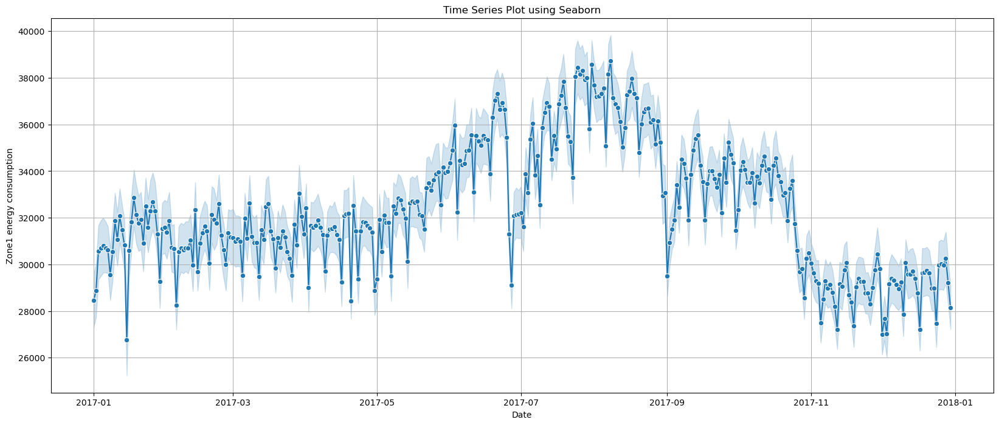

In [36]:
plt.figure(figsize=(20, 8))
sns.lineplot(x='date', y='zone1', data=data, marker='o')
plt.title('Time Series Plot using Seaborn')
plt.xlabel('Date')
plt.ylabel('Zone1 energy consumption')
plt.grid(True)
plt.show()

In [37]:
fig = px.line(data, x='date', y='zone2', title='Date v/s Zone2 energy Usage')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Zone2 Energy Consumption')
fig.update_layout(
    width=1500,  
    height=600  
)
fig.show()

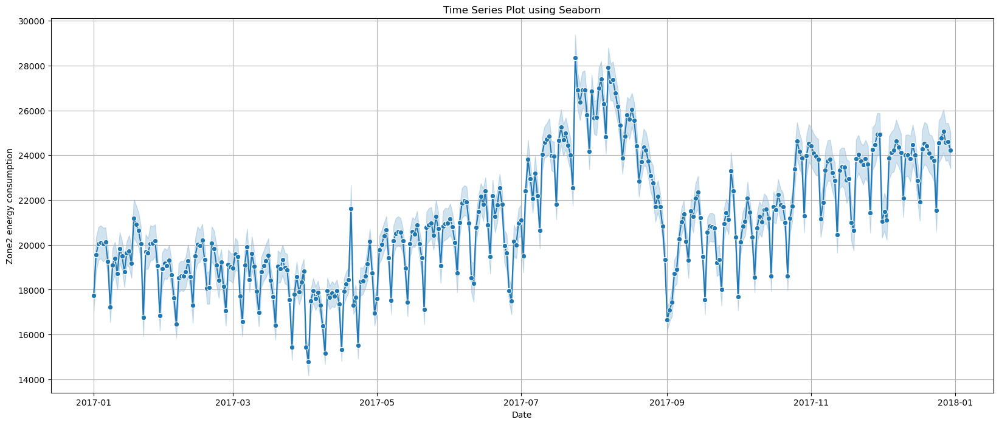

In [38]:
plt.figure(figsize=(20, 8))
sns.lineplot(x='date', y='zone2', data=data, marker='o')
plt.title('Time Series Plot using Seaborn')
plt.xlabel('Date')
plt.ylabel('Zone2 energy consumption')
plt.grid(True)
plt.show()

In [39]:
fig = px.line(data, x='date', y='zone3', title='Date v/s Zone3 energy Usage')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Zone3 Energy Consumption')
fig.update_layout(
    width=1500,  
    height=600  
)
fig.show()

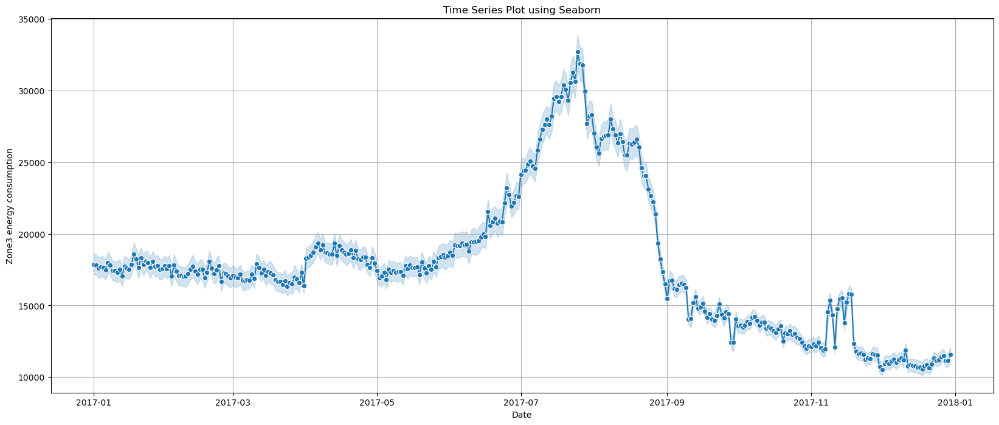

In [40]:
plt.figure(figsize=(20, 8))
sns.lineplot(x='date', y='zone3', data=data, marker='o')
plt.title('Time Series Plot using Seaborn')
plt.xlabel('Date')
plt.ylabel('Zone3 energy consumption')
plt.grid(True)
plt.show()

# Forecasting Models --------------------

In [4]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split,learning_curve
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from datetime import datetime
from sklearn.tree import DecisionTreeRegressor
from sklearn import metrics

In [5]:
df = pd.read_csv('powerconsumption.csv')

df['Datetime'] = pd.to_datetime(df['Datetime'], format='mixed')

df['Hour'] = df['Datetime'].dt.hour
df['Day'] = df['Datetime'].dt.day
df['Month'] = df['Datetime'].dt.month
df['DayOfWeek'] = df['Datetime'].dt.dayofweek

df = df.drop('Datetime', axis=1)

X = df.drop(['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3'], axis=1)
y = df[['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [6]:
df

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Hour,Day,Month,DayOfWeek
0,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386,0,1,1,6
1,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434,0,1,1,6
2,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373,0,1,1,6
3,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711,0,1,1,6
4,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964,0,1,1,6
...,...,...,...,...,...,...,...,...,...,...,...,...
52411,7.010,72.4,0.080,0.040,0.096,31160.45627,26857.31820,14780.31212,23,30,12,5
52412,6.947,72.6,0.082,0.051,0.093,30430.41825,26124.57809,14428.81152,23,30,12,5
52413,6.900,72.8,0.086,0.084,0.074,29590.87452,25277.69254,13806.48259,23,30,12,5
52414,6.758,73.0,0.080,0.066,0.089,28958.17490,24692.23688,13512.60504,23,30,12,5


### Linear Regression --------------

In [43]:
X = df[['Temperature', 'Humidity', 'WindSpeed', 'GeneralDiffuseFlows', 'DiffuseFlows', 'Hour', 'Day', 'Month', 'DayOfWeek']]
y = df[['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

for i, zone in enumerate(['Zone1', 'Zone2', 'Zone3']):
    mae = mean_absolute_error(y_test.iloc[:, i], y_pred[:, i])
    mse = mean_squared_error(y_test.iloc[:, i], y_pred[:, i])
    r2 = r2_score(y_test.iloc[:, i], y_pred[:, i])
    print(f"{zone} - MAE: {mae}, MSE: {mse}, R²: {r2}")

Zone1 - MAE: 3372.028000144995, MSE: 18026145.924616292, R²: 0.6471304934529204
Zone2 - MAE: 2620.3686890607123, MSE: 10988287.544172585, R²: 0.5957647747743846
Zone3 - MAE: 3290.0956589562293, MSE: 17330661.538116124, R²: 0.6058111318027943


### Polynomial Regression ---------

In [44]:
X = df[['Temperature', 'Humidity', 'WindSpeed', 'GeneralDiffuseFlows', 'DiffuseFlows', 'Hour', 'Day', 'Month', 'DayOfWeek']]
y = df[['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

poly = PolynomialFeatures(degree=3)
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

model = LinearRegression()
model.fit(X_train_poly, y_train)

y_pred = model.predict(X_test_poly)

for i, zone in enumerate(['Zone1', 'Zone2', 'Zone3']):
    mae = mean_absolute_error(y_test.iloc[:, i], y_pred[:, i])
    mse = mean_squared_error(y_test.iloc[:, i], y_pred[:, i])
    r2 = r2_score(y_test.iloc[:, i], y_pred[:, i])
    print(f"{zone} - MAE: {mae}, MSE: {mse}, R²: {r2}")


Zone1 - MAE: 1804.2956776818874, MSE: 5833564.344438833, R²: 0.8844710321347147
Zone2 - MAE: 1443.022245725548, MSE: 3595063.245574821, R²: 0.8667983588617624
Zone3 - MAE: 1723.9443197692146, MSE: 5205863.618580643, R²: 0.8806118449261467


### Random Forest Regressor Model --------

In [45]:
rf_regressor = RandomForestRegressor(n_estimators=100,max_depth=5,min_samples_split=5,min_samples_leaf=4, random_state=42)

multi_rf_regressor = MultiOutputRegressor(rf_regressor)
multi_rf_regressor.fit(X_train, y_train)

y_pred = multi_rf_regressor.predict(X_test)

mae_zone1 = mean_absolute_error(y_test['PowerConsumption_Zone1'], y_pred[:, 0])
mse_zone1 = mean_squared_error(y_test['PowerConsumption_Zone1'], y_pred[:, 0])
r2_zone1 = r2_score(y_test['PowerConsumption_Zone1'], y_pred[:, 0])

mae_zone2 = mean_absolute_error(y_test['PowerConsumption_Zone2'], y_pred[:, 1])
mse_zone2 = mean_squared_error(y_test['PowerConsumption_Zone2'], y_pred[:, 1])
r2_zone2 = r2_score(y_test['PowerConsumption_Zone2'], y_pred[:, 1])

mae_zone3 = mean_absolute_error(y_test['PowerConsumption_Zone3'], y_pred[:, 2])
mse_zone3 = mean_squared_error(y_test['PowerConsumption_Zone3'], y_pred[:, 2])
r2_zone3 = r2_score(y_test['PowerConsumption_Zone3'], y_pred[:, 2])

print(f"Zone 1 - MAE: {mae_zone1}, MSE: {mse_zone1}, R²: {r2_zone1}")
print(f"Zone 2 - MAE: {mae_zone2}, MSE: {mse_zone2}, R²: {r2_zone2}")
print(f"Zone 3 - MAE: {mae_zone3}, MSE: {mse_zone3}, R²: {r2_zone3}")


Zone 1 - MAE: 1960.7184357005565, MSE: 6834106.973928151, R²: 0.8646561041652797
Zone 2 - MAE: 1625.821129468865, MSE: 4526092.7863830775, R²: 0.8323025365875674
Zone 3 - MAE: 1591.1127220916421, MSE: 4965940.971647156, R²: 0.8861140870662576


### predicting Function -------

In [47]:
def predict_energy_consumption():
    user_input = input("Enter the date and time (dd-mm-yyyy HH:MM): ")
    user_datetime = pd.to_datetime(user_input, format='%d-%m-%Y %H:%M')

    user_hour = user_datetime.hour
    user_day = user_datetime.day
    user_month = user_datetime.month
    user_dayofweek = user_datetime.dayofweek

    user_temp = float(input("Enter temperature: "))
    user_humidity = float(input("Enter humidity: "))
    user_wind_speed = float(input("Enter wind speed: "))
    user_gen_diff_flows = float(input("Enter general diffuse flows: "))
    user_diff_flows = float(input("Enter diffuse flows: "))

    user_data = pd.DataFrame({
        'Temperature': [user_temp],
        'Humidity': [user_humidity],
        'WindSpeed': [user_wind_speed],
        'GeneralDiffuseFlows': [user_gen_diff_flows],
        'DiffuseFlows': [user_diff_flows],
        'Hour': [user_hour],
        'Day': [user_day],
        'Month': [user_month],
        'DayOfWeek': [user_dayofweek]
    })

    user_data_scaled = scaler.transform(user_data)

    user_pred = multi_rf_regressor.predict(user_data_scaled)

    print(f"Predicted Energy Consumption for Zone 1: {user_pred[0][0]:.2f}")
    print(f"Predicted Energy Consumption for Zone 2: {user_pred[0][1]:.2f}")
    print(f"Predicted Energy Consumption for Zone 3: {user_pred[0][2]:.2f}")

predict_energy_consumption()

Enter the date and time (dd-mm-yyyy HH:MM): 22-05-2025 12:00
Enter temperature: 12
Enter humidity: 23
Enter wind speed: 90
Enter general diffuse flows: 2
Enter diffuse flows: 12
Predicted Energy Consumption for Zone 1: 28006.57
Predicted Energy Consumption for Zone 2: 16654.50
Predicted Energy Consumption for Zone 3: 16159.30


C:\Users\infor\anaconda3\Lib\site-packages\sklearn\base.py:464: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names

C:\Users\infor\anaconda3\Lib\site-packages\sklearn\base.py:464: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names

C:\Users\infor\anaconda3\Lib\site-packages\sklearn\base.py:464: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



In [48]:
df.sample()

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Hour,Day,Month,DayOfWeek
50665,14.9,79.1,0.084,0.062,0.137,40048.6692,33753.91224,15834.81393,20,18,12,0


### Checking for Overfitting --------

In [49]:
y_train_pred = multi_rf_regressor.predict(X_train)
y_test_pred = multi_rf_regressor.predict(X_test)

mae_train = mean_absolute_error(y_train, y_train_pred)
mse_train = mean_squared_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

mae_test = mean_absolute_error(y_test, y_test_pred)
mse_test = mean_squared_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print(f"Training Set - MAE: {mae_train}, MSE: {mse_train}, R²: {r2_train}")
print(f"Test Set - MAE: {mae_test}, MSE: {mse_test}, R²: {r2_test}")

if r2_train > r2_test:
    print("The model may be overfitting since the training R² is higher than the test R².")
else:
    print("The model does not seem to be overfitting.")

Training Set - MAE: 1729.6172355858587, MSE: 5495429.05661971, R²: 0.8604940707611627
Test Set - MAE: 1725.884095753688, MSE: 5442046.910652795, R²: 0.8610242426063683
The model does not seem to be overfitting.


### Learning Curve -------

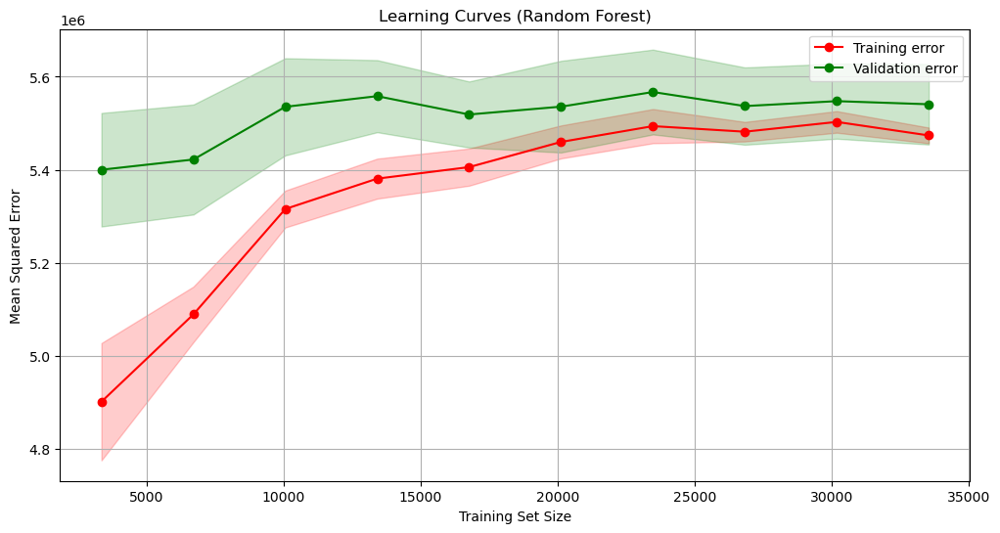

In [50]:
train_sizes, train_scores, test_scores = learning_curve(
    estimator=multi_rf_regressor,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',  # Negative MSE to follow the convention of `learning_curve`
    n_jobs=-1
)

# Calculate mean and standard deviation for training and test scores
train_scores_mean = -np.mean(train_scores, axis=1)  # Convert negative MSE to positive
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = -np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.figure(figsize=(12, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='r', label='Training error')
plt.plot(train_sizes, test_scores_mean, 'o-', color='g', label='Validation error')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2, color='r')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2, color='g')
plt.xlabel('Training Set Size')
plt.ylabel('Mean Squared Error')
plt.title('Learning Curves (Random Forest)')
plt.legend(loc='best')
plt.grid(True)
plt.show()

### Ridge Regression -------

In [51]:
ridge_regressor = Ridge(alpha=1.0, random_state=42)

multi_ridge_regressor = MultiOutputRegressor(ridge_regressor)
multi_ridge_regressor.fit(X_train, y_train)

y_pred = multi_ridge_regressor.predict(X_test)

mae_zone1 = mean_absolute_error(y_test['PowerConsumption_Zone1'], y_pred[:, 0])
mse_zone1 = mean_squared_error(y_test['PowerConsumption_Zone1'], y_pred[:, 0])
r2_zone1 = r2_score(y_test['PowerConsumption_Zone1'], y_pred[:, 0])

mae_zone2 = mean_absolute_error(y_test['PowerConsumption_Zone2'], y_pred[:, 1])
mse_zone2 = mean_squared_error(y_test['PowerConsumption_Zone2'], y_pred[:, 1])
r2_zone2 = r2_score(y_test['PowerConsumption_Zone2'], y_pred[:, 1])

mae_zone3 = mean_absolute_error(y_test['PowerConsumption_Zone3'], y_pred[:, 2])
mse_zone3 = mean_squared_error(y_test['PowerConsumption_Zone3'], y_pred[:, 2])
r2_zone3 = r2_score(y_test['PowerConsumption_Zone3'], y_pred[:, 2])

print(f"Zone 1 - MAE: {mae_zone1}, MSE: {mse_zone1}, R²: {r2_zone1}")
print(f"Zone 2 - MAE: {mae_zone2}, MSE: {mse_zone2}, R²: {r2_zone2}")
print(f"Zone 3 - MAE: {mae_zone3}, MSE: {mse_zone3}, R²: {r2_zone3}")


Zone 1 - MAE: 3345.1087214007835, MSE: 17752317.80023437, R²: 0.6484298738158687
Zone 2 - MAE: 2621.4608362725753, MSE: 10941366.319183407, R²: 0.5946085366359555
Zone 3 - MAE: 3281.7872964525477, MSE: 17209627.709006418, R²: 0.6053247160849895


In [ ]:
# LSTM , SVR, SARIMA, 

## Decision Trees Regressor --------------------------------------

In [34]:
X=df.iloc[:,0:5]
y=df.iloc[:,5]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
rt = DecisionTreeRegressor(criterion='poisson',splitter='best',max_depth=10)
rt.fit(X_train,y_train)
y_pred = rt.predict(X_test)
r2= r2_score(y_test,y_pred)
print('Zone 1 -> r2_score = ',r2)
print("\n")
print('Feature importances ------------')
for importance,name in sorted(zip(rt.feature_importances_,X_train.columns),reverse=True):
    print(name,importance)

print('\n\n')
y1=df.iloc[:,6]
X_train, X_test, y1_train, y1_test = train_test_split(X, y1, test_size=0.2, random_state=42)
rt1 = DecisionTreeRegressor(criterion='poisson',splitter='best',max_depth=13)
rt1.fit(X_train,y1_train)
y1_pred = rt1.predict(X_test)
r21= r2_score(y1_test,y1_pred)
r21
print('Zone2 -> r2_score = ',r21)
print("\n")
print('Feature importances ------------')
for importance,name in sorted(zip(rt1.feature_importances_,X_train.columns),reverse=True):
    print(name,importance)

print('\n\n')
y3=df.iloc[:,7]
X_train, X_test, y3_train, y3_test = train_test_split(X, y3, test_size=0.2, random_state=42)
rt2 = DecisionTreeRegressor(criterion='squared_error',splitter='best',max_depth=10)
rt2.fit(X_train,y3_train)
y3_pred = rt2.predict(X_test)
r23= r2_score(y3_test,y3_pred)
print('Zone3 -> r2_score = ',r23)
print("\n")
print('Feature importances ------------')
for importance,name in sorted(zip(rt2.feature_importances_,X_train.columns),reverse=True):
    print(name,importance)

Zone 1 -> r2_score =  0.38229191677834673


Feature importances ------------
Temperature 0.5411137167588681
Humidity 0.16074832383959825
WindSpeed 0.12120053860539966
GeneralDiffuseFlows 0.11256513015119098
DiffuseFlows 0.06437229064494297



Zone2 -> r2_score =  0.37436393963016645


Feature importances ------------
Temperature 0.4110510885050387
Humidity 0.23109423542838972
WindSpeed 0.130348416450358
GeneralDiffuseFlows 0.12275727067018934
DiffuseFlows 0.1047489889460242



Zone3 -> r2_score =  0.5634274358841487


Feature importances ------------
Temperature 0.5778383652486758
GeneralDiffuseFlows 0.1551987014607527
WindSpeed 0.11731648989994506
Humidity 0.11710712702844629
DiffuseFlows 0.03253931636218013


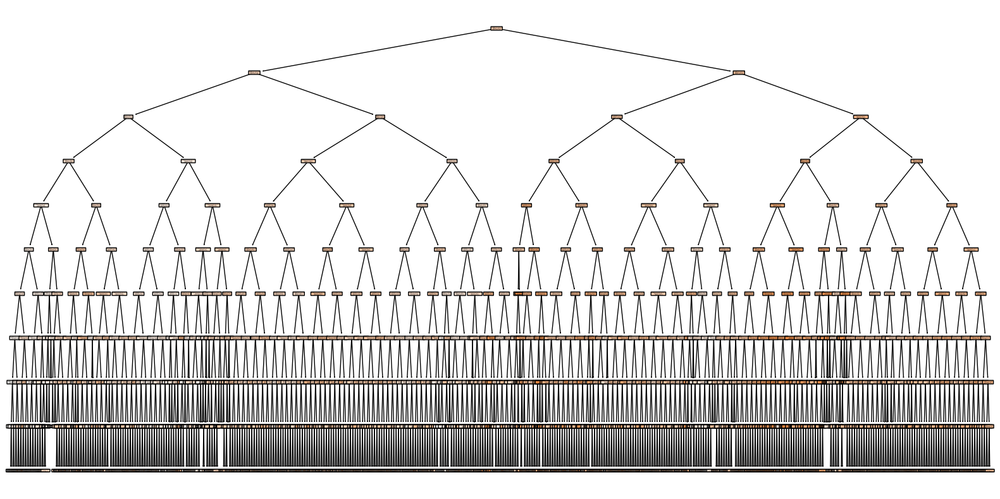

In [99]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

feature_names = X_train.columns.tolist()
plt.figure(figsize=(20,10))
plot_tree(rt, feature_names=feature_names, filled=True, rounded=True)
plt.show()

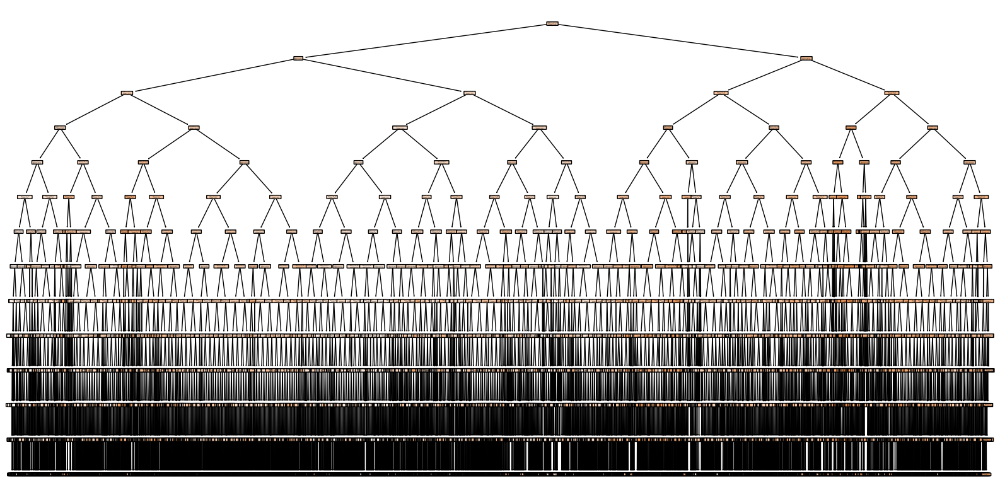

In [100]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

feature_names = X_train.columns.tolist()
plt.figure(figsize=(20,10))
plot_tree(rt1, feature_names=feature_names, filled=True, rounded=True)
plt.show()

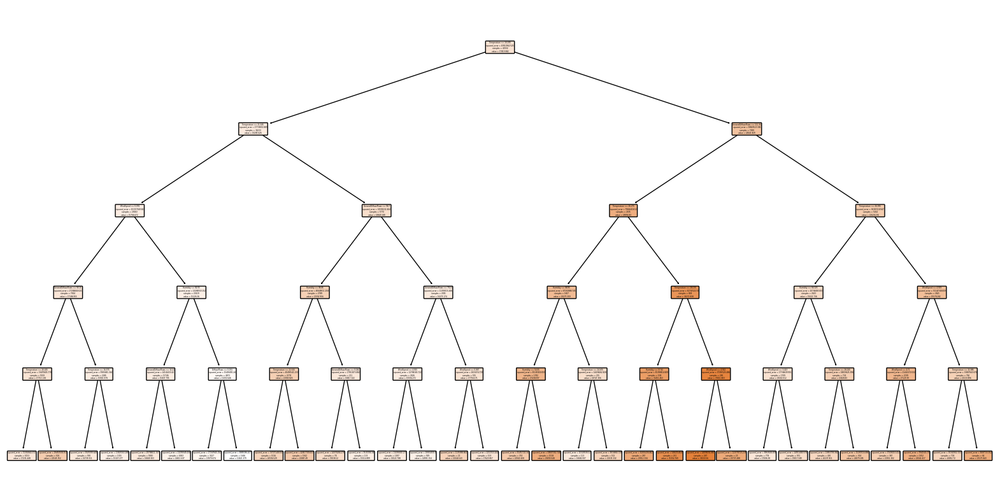

In [92]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

feature_names = X_train.columns.tolist()
plt.figure(figsize=(20,10))
plot_tree(rt2, feature_names=feature_names, filled=True, rounded=True)
plt.show()


In [20]:
from dtreeviz.trees import *
from dtreeviz import dtreeviz

In [21]:
import graphviz.backend as be
from IPython.display import Image,display_svg,SVG


In [29]:
print(type(X_train))
print(type(y_train))

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>


In [39]:
feature_names = X_train.columns.tolist()


In [40]:
viz = dtreeviz(rt2,
                X_train, 
                y_train, 
                target_name='Power Consumption Zone 3', 
                feature_names=feature_names,  
                title='Decision Tree for Zone 3')

viz.view()

C:\Users\infor\AppData\Local\Temp\ipykernel_12348\2916227178.py:1: DeprecationWarning: dtreeviz() function is deprecated starting from version 2.0. 
 For the same functionality, please use this code instead: 
 m = dtreeviz.model(...) 
 m.view()


TypeError: 'int' object is not subscriptable